# Unit 2 Build 2

#### My data is sourced from their most recent release at the time of writing (March 7, 2020). While my model is strictly for educational purposes I hope it may offer some value in helping better understand what type of animals find homes, since as we gain understanding we can concentrate efforts more effectively on the animals that are the highest risk for negative outcomes such as being harder to find homes alongside Euthanasias and death.


## Setup:

In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score, plot_confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import RandomizedSearchCV

import eli5
from eli5.sklearn import PermutationImportance

import shap

from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier

import category_encoders as ce

import chart_studio.plotly
import plotly.graph_objects as go
import plotly.express as px

from pandas_profiling import ProfileReport
import string

C:\Users\chris.DESKTOP-4GC6C9H\Anaconda3\envs\unit2\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
C:\Users\chris.DESKTOP-4GC6C9H\Anaconda3\envs\unit2\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


#### data credits to: https://data.austintexas.gov/Health-and-Community-Services/Austin-Animal-Center-Outcomes/9t4d-g238

In [2]:
df = pd.read_csv('..\data\shelter\shelter_updated.csv')

In [3]:
df.head()

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,Breed,Color
0,A794011,Chunk,05/08/2019 06:20:00 PM,05/08/2019 06:20:00 PM,05/02/2017,Rto-Adopt,NaN,Cat,Neutered Male,2 years,Domestic Shorthair Mix,Brown Tabby/White
1,A776359,Gizmo,07/18/2018 04:02:00 PM,07/18/2018 04:02:00 PM,07/12/2017,Adoption,NaN,Dog,Neutered Male,1 year,Chihuahua Shorthair Mix,White/Brown
2,A720371,Moose,02/13/2016 05:59:00 PM,02/13/2016 05:59:00 PM,10/08/2015,Adoption,NaN,Dog,Neutered Male,4 months,Anatol Shepherd/Labrador Retriever,Buff
3,A674754,NaN,03/18/2014 11:47:00 AM,03/18/2014 11:47:00 AM,03/12/2014,Transfer,Partner,Cat,Intact Male,6 days,Domestic Shorthair Mix,Orange Tabby
4,A689724,*Donatello,10/18/2014 06:52:00 PM,10/18/2014 06:52:00 PM,08/01/2014,Adoption,NaN,Cat,Neutered Male,2 months,Domestic Shorthair Mix,Black


In [4]:
df.columns

Index(['Animal ID', 'Name', 'DateTime', 'MonthYear', 'Date of Birth',
       'Outcome Type', 'Outcome Subtype', 'Animal Type', 'Sex upon Outcome',
       'Age upon Outcome', 'Breed', 'Color'],
      dtype='object')

In [5]:
df['Breed'].unique()

array(['Domestic Shorthair Mix', 'Chihuahua Shorthair Mix',
       'Anatol Shepherd/Labrador Retriever', ..., 'Ibizan Hound',
       'Dwarf Hotot', 'Landseer/Great Pyrenees'], dtype=object)

In [6]:
# I think the amount of Other, Bird, and Livestock are neglectable
# I don't believe them to have enough data to train a model effectively train a model compared to dogs and cats
print(f'Before\n{df.shape}')
print(df['Animal Type'].value_counts(normalize=True))

Before
(116211, 12)
Dog          0.568182
Cat          0.375541
Other        0.051484
Bird         0.004638
Livestock    0.000155
Name: Animal Type, dtype: float64


#### My dataset consists of largely categorical data of cats and dogs while it does contain entries for other animals (around 5%) for this project I’m going to be focusing strictly on our canine and feline friends.

In [7]:
df = df[(df['Animal Type'] == 'Cat') | (df['Animal Type'] == 'Dog')]
print(f'\nAfter\n{df.shape}')
print(df['Animal Type'].value_counts(normalize=True))


After
(109671, 12)
Dog    0.602064
Cat    0.397936
Name: Animal Type, dtype: float64


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 109671 entries, 0 to 116210
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Animal ID         109671 non-null  object
 1   Name              78953 non-null   object
 2   DateTime          109671 non-null  object
 3   MonthYear         109671 non-null  object
 4   Date of Birth     109671 non-null  object
 5   Outcome Type      109670 non-null  object
 6   Outcome Subtype   47321 non-null   object
 7   Animal Type       109671 non-null  object
 8   Sex upon Outcome  109668 non-null  object
 9   Age upon Outcome  109664 non-null  object
 10  Breed             109671 non-null  object
 11  Color             109671 non-null  object
dtypes: object(12)
memory usage: 10.9+ MB


In [9]:
df.sample(10)

,Animal ID,Name,DateTime,MonthYear,Date of Birth,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Age upon Outcome,Breed,Color
74035,A795843,Kenya,05/28/2019 11:14:00 AM,05/28/2019 11:14:00 AM,05/25/2017,Return to Owner,NaN,Dog,Spayed Female,2 years,Chihuahua Shorthair,Brown/White
81070,A775053,*Vinny,08/21/2018 02:10:00 PM,08/21/2018 02:10:00 PM,04/23/2018,Adoption,Foster,Cat,Neutered Male,3 months,Domestic Shorthair Mix,Blue/White
97588,A709311,*Costello,10/06/2015 03:34:00 PM,10/06/2015 03:34:00 PM,07/07/2015,Adoption,NaN,Cat,Neutered Male,2 months,Domestic Shorthair Mix,White/Brown Tabby
30419,A663798,Laika,01/03/2014 12:51:00 PM,01/03/2014 12:51:00 PM,09/24/2007,Adoption,NaN,Dog,Spayed Female,6 years,Labrador Retriever Mix,Yellow
19906,A718568,Barry,01/02/2016 09:27:00 PM,01/02/2016 09:27:00 PM,01/02/2011,Return to Owner,NaN,Dog,Intact Male,5 years,Lhasa Apso Mix,White/Black
61171,A778360,Scrappy,08/25/2018 05:04:00 PM,08/25/2018 05:04:00 PM,08/13/2007,Return to Owner,NaN,Dog,Neutered Male,11 years,Shih Tzu Mix,Tan
48751,A707480,Scooby,03/02/2017 09:54:00 AM,03/02/2017 09:54:00 AM,07/13/2012,Return to Owner,NaN,Dog,Neutered Male,4 years,Dachshund/Chihuahua Shorthair,Brown
35085,A694745,Herc,01/09/2015 06:24:00 PM,01/09/2015 06:24:00 PM,07/03/2011,Return to Owner,NaN,Dog,Neutered Male,3 years,Pit Bull Mix,Brown
59213,A731558,Sydney,07/25/2016 01:23:00 PM,07/25/2016 01:23:00 PM,07/24/2010,Return to Owner,NaN,Dog,Spayed Female,6 years,Australian Shepherd Mix,Chocolate/White
32925,A788932,Marsha,02/18/2019 04:51:00 PM,02/18/2019 04:51:00 PM,02/11/2018,Adoption,NaN,Dog,Spayed Female,1 year,German Shepherd,Black/Tan


In [10]:
df.isnull().sum()

Animal ID               0
Name                30718
DateTime                0
MonthYear               0
Date of Birth           0
Outcome Type            1
Outcome Subtype     62350
Animal Type             0
Sex upon Outcome        3
Age upon Outcome        7
Breed                   0
Color                   0
dtype: int64

## Choose my target:
Which columns will I predict?

#### My object with this build is to look at the "Outcome Type" class. It is a multi class classification target that originally consisted of 8 unique values. I dropped four of the values (Died, Rto-Adopt, Disposal, Missing) that were in the dataset as they accounted for less that 1.5% combined in the dataset. I didn't think keeping them would produce good results with predicting later in the build. My goal is to predict the probability of each of the remaining outcome types while showing through a plotly app how different changes in other classes affect the  probability of the Outcomes. My target's classes are well distrubuted once the four low ocurring outcomes were removed.

In [11]:
df['Outcome Type'].value_counts(normalize=True)

Adoption           0.461184
Transfer           0.306492
Return to Owner    0.185548
Euthanasia         0.032242
Died               0.007906
Rto-Adopt          0.005343
Disposal           0.000702
Missing            0.000584
Name: Outcome Type, dtype: float64

In [12]:
# Going to drop the columns with less than 1% of ocurrance together they combine for less than 1.5% of the data
# currently I don't think there's enough information to train the model and the subtype don't give me any prior
# information such as the rabies in euthanasia

df = df[(df['Outcome Type'] == 'Adoption') | (df['Outcome Type'] == 'Transfer') | (df['Outcome Type'] == 'Return to Owner') | (df['Outcome Type'] == 'Euthanasia')]

In [13]:
print({df.shape})

y = df['Outcome Type']
print(y.value_counts(normalize=True))

print(f'My target has {y.nunique()} classes.')

{(108076, 12)}
Adoption           0.467985
Transfer           0.311013
Return to Owner    0.188284
Euthanasia         0.032718
Name: Outcome Type, dtype: float64
My target has 4 classes.


In [14]:
holder = df[df['Outcome Type'] == 'Euthanasia']
holder['Outcome Subtype'].unique()

array(['Suffering', 'Aggressive', 'Rabies Risk', 'At Vet', 'Behavior',
       'Medical', 'Court/Investigation', nan, 'Underage'], dtype=object)

## Wrangle / Clean

### Some of the notable data wrangling I performed:

#### I found that the included Age upon Outcome class was not very useful in it's original state. It consisted of imprecise values (eg: 2 weeks, 5 years, 8 months, ect). What I did was take the DateTime and Date of Birth classes (both of which didn't have hardly any missing values) and subtracted them producing a datatime day value, which resulted in a usable Outcome Age (days) class.

#### Some of the classes combinded data that was more useful as seperate classes. For example I took the Sex upon Outcome and split the data into a Sex and Spay/Neuter classes. One to show if it was male or female and one to show if the animal was intact or spayed or neutered.

#### I wanted to only use certain aspects of the originals datasets "Outcome Subtype" as I felt it consisted of data leakage as most of the values could only be known once the Outcome was also known. On the other hand it does have values that we would know prior to the outcome such as if the animal had rabies or was suffering.


### Some of the notable data cleaning I performed:

#### To try to reduce the high cardinality of color and breed classes I only kept colors and breeds that had ocurrences of 275 and 200 respectively. All other colors and breeds that couldn't meet that threshold were marked as other.

#### Also in the name category there were random punctuations in the values that I removed. 

#### I ultimately changed the case of the entire dataset to lowercase as I didn't want to deal with values being read as different values because of case

In [15]:
def wrangle(X):
    # Select the non numerical features
    X_feats = X.drop(columns=['Date of Birth', 'DateTime', 'MonthYear'])
    cat_feats = X_feats.select_dtypes(exclude='number').columns.tolist()
    
    X['Date of Birth'] = pd.to_datetime(X['Date of Birth'])
    X['DateTime'] = pd.to_datetime(X['DateTime'])
    # Give true days at age of outcome
    X['Outcome Age (days)'] =  (X['DateTime'] - X['Date of Birth']).dt.days
    
    X['Day of Birth'] =  (X['Date of Birth']).dt.day
    X['Month of Birth'] =  (X['Date of Birth']).dt.month
    X['Year of Birth'] =  (X['Date of Birth']).dt.year
    # Makes sure to clean up any ages lower than 0
    X[X['Outcome Age (days)'] < 0] = 0
    
    X['Day of Birth'] = X['Day of Birth'].astype(int)
    X['Month of Birth'] = X['Month of Birth'].astype(int)
    X['Year of Birth'] = X['Year of Birth'].astype(int)
    
    

    # Splits Sex upon Outcome into to independent columns
    # Animal sex
    X['Sex'] = np.where(X['Sex upon Outcome'].str.contains('Male'), 'Male', 'Female')
    # Spayed or Neutered
    X['Spay/Neuter'] = np.where(X['Sex upon Outcome'].str.contains('Intact'), False, True)
    
    # Try to reduce the high cardinality for colors of the dogs and cats
    color_counts = X['Color'].value_counts()
    color_others = set(color_counts[color_counts <= 275].index)
    X['Color'] = X['Color'].replace(list(color_others), 'Others')
    
    
    
    # Check if it's a kitten (under 180 days of age)
    def kits(C):
        if (C['Outcome Age (days)'] <= 180) & (C['Animal Type'] == 'Cat'):
            value = 1
        else:
            value = 0
        return value
    X['Kitten'] = X.apply(kits, axis=1)
    # Check if it's a puppy (under 180 days of age)
    def pups(D):
        if (D['Outcome Age (days)'] <= 180) & (D['Animal Type'] == 'Dog'):
            value = 1
        else:
            value = 0
        return value
    X['Puppy'] = X.apply(pups, axis=1)

    #data['Age Group'] = pd.cut(data['Outcome Age (days)'], 10)

    # Makes all non numerical values lowercase
    for col in cat_feats:
        X[col] = X[col].str.lower()

    # Assume that animals without names don't have one or it's unknown
    X['Name'].fillna('no name', inplace=True)
    # Missing subtypes seem to be caused by types that wouldn't have that value to began with
    X['Outcome Subtype'].fillna('no subtype', inplace=True)

    def text_process(x):
        # Takes in a string and return it without punctuations
        # Replaces / with spaces
        text = x.replace('/', ' ')
        return ''.join([char for char in x if char not in string.punctuation])
    
    # processes text_process on columns
    for col in cat_feats:
        X[col] = X[col].apply(lambda x:text_process(str(x)))
    
    # Trying to use the Outcome Subtype column without using it because it's Leakage as only certian subtypes occurs
    # based on subtypes and some the subtypes can only be known after the outcome but some like rabies and suffering are
    # things you can learn prior
    X['Rabies'] = np.where(X['Outcome Subtype'].str.contains('rabies'), 1, 0)
    X['Suffering'] = np.where(X['Outcome Subtype'].str.contains('suffering'), 1, 0)
    X['Aggressive'] = np.where(X['Outcome Subtype'].str.contains('aggressive'), 1, 0)
    X['Medical Issues'] = np.where(X['Outcome Subtype'].str.contains('medical'), 1, 0)
    
    # Try to reduce the high cardinality for breed of the dogs and cats only allowing animals with 200 examples only
    breed_counts = X['Breed'].value_counts()
    breed_others = set(color_counts[color_counts <= 200].index)
    X['Breed'] = X['Breed'].replace(list(color_others), 'Others')
    
    X['Bulldog'] = np.where(X['Breed'].str.contains('bull'), 1, 0)
    X['Retriever'] = np.where(X['Breed'].str.contains('retriever'), 1, 0)
    X['Mix Breed'] = np.where(X['Breed'].str.contains('mix'), 0, 1)
    

    # Not useful after I split the column abX    X.drop('Sex upon Outcome', axis=1, inplace=True)
    # Remove the age_upon_outcome because I have the days_of_age column
    X.drop('Age upon Outcome', axis=1, inplace=True)
    # Also drop the date_of_birth, datetime and monthyear of our dataset for simplicity
    X.drop(['Date of Birth', 'DateTime', 'MonthYear'], axis=1, inplace=True)
    # The animal_id column is made of unique values that add nothing to the model
    X.drop('Animal ID', axis=1, inplace=True)
    
    return X

In [16]:
data = df.copy()
wrangle(data)

,Name,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Breed,Color,Outcome Age (days),Day of Birth,Month of Birth,...,Spay/Neuter,Kitten,Puppy,Rabies,Suffering,Aggressive,Medical Issues,Bulldog,Retriever,Mix Breed
1,gizmo,adoption,no subtype,dog,neutered male,chihuahua shorthair mix,whitebrown,371,12,7,...,True,0,0,0,0,0,0,0,0,0
2,moose,adoption,no subtype,dog,neutered male,anatol shepherdlabrador retriever,buff,128,8,10,...,True,0,1,0,0,0,0,0,1,1
3,no name,transfer,partner,cat,intact male,domestic shorthair mix,orange tabby,6,12,3,...,False,1,0,0,0,0,0,0,0,0
4,donatello,adoption,no subtype,cat,neutered male,domestic shorthair mix,black,78,1,8,...,True,1,0,0,0,0,0,0,0,0
5,zeus,adoption,no subtype,cat,neutered male,domestic shorthair mix,others,63,3,6,...,True,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116205,mochi,adoption,no subtype,cat,spayed female,domestic shorthair,orange tabby,357,13,3,...,True,0,0,0,0,0,0,0,0,1
116207,mona,adoption,no subtype,cat,spayed female,domestic shorthair,blackwhite,836,19,11,...,True,0,0,0,0,0,0,0,0,1
116208,no name,adoption,no subtype,cat,spayed female,domestic longhair mix,others,96,29,11,...,True,1,0,0,0,0,0,0,0,0
116209,togo,adoption,no subtype,dog,neutered male,alaskan husky,others,1145,14,1,...,True,0,0,0,0,0,0,0,0,1


In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108076 entries, 1 to 116210
Data columns (total 22 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   Name                108076 non-null  object
 1   Outcome Type        108076 non-null  object
 2   Outcome Subtype     108076 non-null  object
 3   Animal Type         108076 non-null  object
 4   Sex upon Outcome    108076 non-null  object
 5   Breed               108076 non-null  object
 6   Color               108076 non-null  object
 7   Outcome Age (days)  108076 non-null  int64 
 8   Day of Birth        108076 non-null  int32 
 9   Month of Birth      108076 non-null  int32 
 10  Year of Birth       108076 non-null  int32 
 11  Sex                 108076 non-null  object
 12  Spay/Neuter         108076 non-null  bool  
 13  Kitten              108076 non-null  int64 
 14  Puppy               108076 non-null  int64 
 15  Rabies              108076 non-null  int32 
 16  Su

In [18]:
data.sample(10)

,Name,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Breed,Color,Outcome Age (days),Day of Birth,Month of Birth,...,Spay/Neuter,Kitten,Puppy,Rabies,Suffering,Aggressive,Medical Issues,Bulldog,Retriever,Mix Breed
12098,dolly,adoption,no subtype,dog,spayed female,miniature schnauzerbeagle,others,1980,6,7,...,True,0,0,0,0,0,0,0,0,1
47388,no name,adoption,foster,dog,neutered male,labrador retriever mix,black,64,25,6,...,True,0,1,0,0,0,0,0,1,0
35136,anakin,return to owner,no subtype,dog,intact male,chihuahua shorthair mix,brownwhite,3652,5,12,...,False,0,0,0,0,0,0,0,0,0
68651,no name,adoption,no subtype,dog,neutered male,catahoula,others,87,9,9,...,True,0,1,0,0,0,0,0,0,1
56683,no name,euthanasia,suffering,cat,intact male,domestic shorthair mix,brown tabbywhite,43,14,5,...,False,1,0,0,1,0,0,0,0,0
72540,loki,return to owner,no subtype,cat,neutered male,domestic longhair mix,brown tabby,4198,20,3,...,True,0,0,0,0,0,0,0,0,0
93967,jasper,adoption,no subtype,dog,neutered male,labrador retriever mix,white,96,16,4,...,True,0,1,0,0,0,0,0,1,0
94116,meowmoew,return to owner,no subtype,cat,spayed female,domestic shorthair mix,brown tabby,4258,27,10,...,True,0,0,0,0,0,0,0,0,0
84470,gracie,adoption,no subtype,dog,spayed female,chihuahua shorthair mix,tan,155,15,11,...,True,0,1,0,0,0,0,0,0,0
49272,sapphyre,adoption,foster,cat,spayed female,domestic shorthair mix,tortie,65,25,1,...,True,1,0,0,0,0,0,0,0,0


In [19]:
data.describe(include='all')

,Name,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Breed,Color,Outcome Age (days),Day of Birth,Month of Birth,...,Spay/Neuter,Kitten,Puppy,Rabies,Suffering,Aggressive,Medical Issues,Bulldog,Retriever,Mix Breed
count,108076,108076,108076,108076,108076,108076,108076,108076.000000,108076.000000,108076.000000,...,108076,108076.000000,108076.000000,108076.000000,108076.000000,108076.000000,108076.000000,108076.000000,108076.00000,108076.000000
unique,14762,5,18,3,6,2352,50,NaN,NaN,NaN,...,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,no name,adoption,no subtype,dog,neutered male,domestic shorthair mix,blackwhite,NaN,NaN,NaN,...,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,30091,50572,61648,65251,40259,30156,11663,NaN,NaN,NaN,...,80571,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,824.647350,15.471650,6.318591,...,NaN,0.232068,0.119444,0.001545,0.022003,0.004922,0.001295,0.109155,0.10277,0.226257
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1095.232764,8.837247,3.255334,...,NaN,0.422154,0.324311,0.039279,0.146694,0.069988,0.035968,0.311835,0.30366,0.418410
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,92.000000,8.000000,4.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,371.000000,15.000000,6.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1096.000000,23.000000,9.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000


## Explore the data

#### Going into this dataset my general assumptions were: 
- that puppy and kittens would be much more likely to be adopted than their older counterparts
- breeds would play a large role in whether an animal is adopted 
- Notorious breeds would be less likely to be adopted due to stereotypes
- Older animals would have a harder time finding homes and may be euthaized more often

In [20]:
# I don't want to keep waiting for it to run each time i restart the kernel
profile = ProfileReport(data, minimal=True)

profile.to_notebook_iframe()

In [21]:
outcome_x = ['Adoption', 'Transfer', 'Return_to_Owner', 'Euthanasia']
outcome_y = list(data['Outcome Type'].value_counts())

fig = go.Figure([go.Bar(
    x=outcome_x,
    y=outcome_y,
    name='Outcome_type',
    marker_color='orange'
)])
fig.show()

#### For this visual I looked at bulldogs and retriever breeds of dogs what I found was.
- total number of bulldog breeds in the dataset is 11,282 while retrievers account for 11,107 so relatively close number
- Bulldogs are more than two times more likely to be euthanised than retrievers
- Bulldogs are about 31% less likely to be adopted over retrievers
#### The data seems to support the notion that notorious breeds are less likely good outcomes 

In [22]:
bull_retri = data[(data['Bulldog']==1) | (data['Retriever']==1)]

fig = px.histogram(bull_retri, x="Outcome Type", y="Outcome Type", color="Retriever")
fig.show()

In [23]:
dogs = data[(data['Animal Type'] == 'dog')]
fig = px.histogram(dogs, x="Outcome Type", y="Sex", color="Puppy")
fig.show()

In [24]:
cats = data[(data['Animal Type'] == 'cat')]
fig = px.histogram(cats, x="Outcome Type", y="Sex", color="Kitten")
fig.show()

In [25]:
fig = px.histogram(data, x="Outcome Age (days)", y='Outcome Type', color="Sex", facet_col='Outcome Type')
fig.show()

In [26]:
data.describe(include='all')

,Name,Outcome Type,Outcome Subtype,Animal Type,Sex upon Outcome,Breed,Color,Outcome Age (days),Day of Birth,Month of Birth,...,Spay/Neuter,Kitten,Puppy,Rabies,Suffering,Aggressive,Medical Issues,Bulldog,Retriever,Mix Breed
count,108076,108076,108076,108076,108076,108076,108076,108076.000000,108076.000000,108076.000000,...,108076,108076.000000,108076.000000,108076.000000,108076.000000,108076.000000,108076.000000,108076.000000,108076.00000,108076.000000
unique,14762,5,18,3,6,2352,50,NaN,NaN,NaN,...,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,no name,adoption,no subtype,dog,neutered male,domestic shorthair mix,blackwhite,NaN,NaN,NaN,...,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,30091,50572,61648,65251,40259,30156,11663,NaN,NaN,NaN,...,80571,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,824.647350,15.471650,6.318591,...,NaN,0.232068,0.119444,0.001545,0.022003,0.004922,0.001295,0.109155,0.10277,0.226257
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1095.232764,8.837247,3.255334,...,NaN,0.422154,0.324311,0.039279,0.146694,0.069988,0.035968,0.311835,0.30366,0.418410
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,92.000000,8.000000,4.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,371.000000,15.000000,6.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1096.000000,23.000000,9.000000,...,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000


## Splitting the data

#### I split my data using sklearn train_test_split holding out 15% of the dataset to test my model on. I didn't leave any data for validation as I planned to use cross validation in the models.

In [27]:
train, test = train_test_split(data, test_size=0.10,
                               stratify=data['Outcome Type'], random_state=42)
train.shape, test.shape

((97268, 22), (10808, 22))

In [28]:
# target to predict
target = 'Outcome Type'

# dropping the target and the outcome_subtype (Certain subtypes only occurs with certain outcomes)
train_features = train.drop(columns=[target, 'Outcome Subtype'])

# Numeric features
num_feats = train_features.select_dtypes(include='number').columns.tolist()

# Catagorical features
cat_feats = train_features.select_dtypes(exclude='number').columns.tolist()



# Combine the lists 
features = num_feats + cat_feats
print(len(features))
print(features)

20
['Outcome Age (days)', 'Day of Birth', 'Month of Birth', 'Year of Birth', 'Kitten', 'Puppy', 'Rabies', 'Suffering', 'Aggressive', 'Medical Issues', 'Bulldog', 'Retriever', 'Mix Breed', 'Name', 'Animal Type', 'Sex upon Outcome', 'Breed', 'Color', 'Sex', 'Spay/Neuter']


In [29]:
X_train = train[features]
X_test = test[features]

y_train = train[target]
y_test = test[target]

## Baseline

#### With my baseline I used a DummyClassifer and ran a for loop to test all strategies. What I found was that choosing the most_frequent occurrence (Adoption) would be your best bet if you were just trying to guess. You'd be right about 47% of the time not even quite 50% which in my opinion wouldn't be very useful if the goal is to tackle animal homelessness effectively.

In [30]:
# most_frequent/prior are the best stratesgies for the baseline
# I get a accuracy score of .467 meaning i'd be right about 47% of the time just by choosing the most frequent outcome
# That would not be useful at all as the
strategies = ['stratified',  'uniform', 'prior', 'most_frequent']

for strategy in strategies:
    baseline = DummyClassifier(strategy = strategy)
    baseline.fit(X_train, y_train)

    y_pred = baseline.predict(X_train)
    base_score = accuracy_score(y_train, y_pred)
    print(f'{strategy} accuracy: {base_score}\n')

stratified accuracy: 0.3502796397581939

uniform accuracy: 0.201957478307357

prior accuracy: 0.46793395566887364

most_frequent accuracy: 0.46793395566887364



## Linear Model

#### I fit a linear model to see how that would perform. I saw a 22% improvement over the baseline model, which was good but I believed the model could be better.

In [31]:
linear = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='mean'),
    StandardScaler(),
    LogisticRegression(solver='lbfgs', n_jobs=-1, penalty='l2', C=1.1)
)

In [32]:
k = 10

scores = cross_val_score(linear, X_train, y_train, cv=k,
                        scoring='roc_auc_ovr',)
print(f'roc_auc for {k} folds: {scores}\nMean roc_auc: {scores.mean()}\nStd roc_auc: {scores.std()}')

roc_auc for 10 folds: [0.9024612  0.89806405 0.90134844 0.8992721  0.897802   0.89942519
 0.90221377 0.89652911 0.89761442 0.90203237]
Mean roc_auc: 0.8996762661692458
Std roc_auc: 0.00207452356294689


In [33]:
linear.fit(X_train, y_train)
y_pred = linear.predict(X_test)
print('Test Accuracy', accuracy_score(y_test, y_pred))

Test Accuracy 0.6922649888971133


## Random Forest

In [34]:
ranfor = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='mean'),
    StandardScaler(),
    RandomForestClassifier(n_estimators=500, criterion='entropy', max_depth=20, random_state=42, n_jobs=-1)
)

In [35]:
k = 3

scores = cross_val_score(ranfor, X_train, y_train, cv=k,
                        scoring='roc_auc_ovr',)
print(f'roc_auc for {k} folds: {scores}\nMean roc_auc: {scores.mean()}\nStd roc_auc: {scores.std()}')

roc_auc for 3 folds: [0.92120824 0.92624008 0.92555266]
Mean roc_auc: 0.9243336565234778
Std roc_auc: 0.0022277521503846773


In [36]:
ranfor.fit(X_train, y_train)
y_pred = ranfor.predict(X_test)
print('Test Accuracy', accuracy_score(y_test, y_pred))

Test Accuracy 0.7487971872686898


In [37]:
'''ranfor = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(),
    StandardScaler(),
    SelectKBest(f_classif),
    RandomForestClassifier(random_state=42, n_jobs=-1)
)

param_distributions = {
    'simpleimputer__strategy': ['mean', 'median'], 
    'selectkbest__k': range(1, len(X_train.columns)+1), 
    'randomforestclassifier__criterion': ['gini', 'entropy'],
    'randomforestclassifier__max_depth': [5,8,10,13,15,17,20],
    'randomforestclassifier__n_estimators': [500,600,700,800,900],
    'randomforestclassifier__max_features': ['auto',0.25,0.75,'log2']
}

# If you're on Colab, decrease n_iter & cv parameters
search = RandomizedSearchCV(
    ranfor, 
    param_distributions=param_distributions, 
    n_iter=100, 
    cv=10, 
    scoring='roc_auc_ovr', 
    verbose=10, 
    return_train_score=True, 
    n_jobs=-1
)

search.fit(X_train, y_train);'''

"ranfor = make_pipeline(\n    ce.OrdinalEncoder(), \n    SimpleImputer(),\n    StandardScaler(),\n    SelectKBest(f_classif),\n    RandomForestClassifier(random_state=42, n_jobs=-1)\n)\n\nparam_distributions = {\n    'simpleimputer__strategy': ['mean', 'median'], \n    'selectkbest__k': range(1, len(X_train.columns)+1), \n    'randomforestclassifier__criterion': ['gini', 'entropy'],\n    'randomforestclassifier__max_depth': [5,8,10,13,15,17,20],\n    'randomforestclassifier__n_estimators': [500,600,700,800,900],\n    'randomforestclassifier__max_features': ['auto',0.25,0.75,'log2']\n}\n\n# If you're on Colab, decrease n_iter & cv parameters\nsearch = RandomizedSearchCV(\n    ranfor, \n    param_distributions=param_distributions, \n    n_iter=100, \n    cv=10, \n    scoring='roc_auc_ovr', \n    verbose=10, \n    return_train_score=True, \n    n_jobs=-1\n)\n\nsearch.fit(X_train, y_train);"

## XGBoost

#### Ultimately I went with my best performing model which was a gradient boosting model. I used XGBoost's library a XGBClassifier model, it predicted my target  with an accuracy of about 76% an almost 29% gain over the baseline model. 

In [38]:
transformer = make_pipeline(
    ce.OrdinalEncoder(), 
)

X_train_transformed = transformer.fit_transform(X_train)
X_test_transformed = transformer.transform(X_test)


eval_set = [(X_train_transformed, y_train), 
            (X_test_transformed, y_test)]

model = XGBClassifier(n_estimators=1000, max_depth = 4, learning_rate = 0.25, n_jobs=-1)

In [39]:
k = 3

scores = cross_val_score(model, X_train_transformed, y_train, cv=k,
                        scoring='roc_auc_ovr',)
print(f'roc_auc for {k} folds: {scores}\nMean roc_auc: {scores.mean()}\nStd roc_auc: {scores.std()}')

roc_auc for 3 folds: [0.9328099  0.93293151 0.91727248]
Mean roc_auc: 0.9276712974710875
Std roc_auc: 0.007353239860209993


In [40]:
model.fit(X_train_transformed, y_train, eval_set=eval_set, eval_metric='merror', early_stopping_rounds=10)

[0]	validation_0-merror:0.299903	validation_1-merror:0.301813
Multiple eval metrics have been passed: 'validation_1-merror' will be used for early stopping.

Will train until validation_1-merror hasn't improved in 10 rounds.
[1]	validation_0-merror:0.287381	validation_1-merror:0.291451
[2]	validation_0-merror:0.287227	validation_1-merror:0.290988
[3]	validation_0-merror:0.287381	validation_1-merror:0.290526
[4]	validation_0-merror:0.284307	validation_1-merror:0.28849
[5]	validation_0-merror:0.283248	validation_1-merror:0.287472
[6]	validation_0-merror:0.282189	validation_1-merror:0.286454
[7]	validation_0-merror:0.277604	validation_1-merror:0.283031
[8]	validation_0-merror:0.277594	validation_1-merror:0.282013
[9]	validation_0-merror:0.275538	validation_1-merror:0.282568
[10]	validation_0-merror:0.275538	validation_1-merror:0.282013
[11]	validation_0-merror:0.273255	validation_1-merror:0.280903
[12]	validation_0-merror:0.272967	validation_1-merror:0.28044
[13]	validation_0-merror:0.272

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.25, max_delta_step=0, max_depth=4,
              min_child_weight=1, missing=None, n_estimators=1000, n_jobs=-1,
              nthread=None, objective='multi:softprob', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [49]:
y_pred = model.predict(X_test_transformed)
print('Test Accuracy', accuracy_score(y_test, y_pred))

Test Accuracy 0.7578645447816432


In [41]:
y_pred_proba = model.predict_proba(X_test_transformed)
print(roc_auc_score(y_test, y_pred_proba, multi_class='ovr'))

y_pred_proba = model.predict_proba(X_test_transformed)

0.9316744610008956


## Model Interpretation

In [42]:
importances = pd.Series(model.feature_importances_, X_train.columns)
fig = go.Figure(go.Bar(
    x=importances.sort_values(),
    y=X_train.columns,
    orientation='h',
    marker_color='grey'
))
fig.update_layout(title='Top Features')

fig.show()

In [43]:
import eli5
from eli5.sklearn import PermutationImportance

permuter = PermutationImportance(
    model, 
    scoring='roc_auc_ovr',
    n_iter=5,
    random_state=42
)

permuter.fit(X_test_transformed, y_test)

PermutationImportance(cv='prefit',
                      estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                              colsample_bylevel=1,
                                              colsample_bynode=1,
                                              colsample_bytree=1, gamma=0,
                                              learning_rate=0.25,
                                              max_delta_step=0, max_depth=4,
                                              min_child_weight=1, missing=None,
                                              n_estimators=1000, n_jobs=-1,
                                              nthread=None,
                                              objective='multi:softprob',
                                              random_state=0, reg_alpha=0,
                                              reg_lambda=1, scale_pos_weight=1,
                                              seed=None, silent=None,
                   

In [44]:
feature_names = X_test.columns.tolist()
eli5.show_weights(
    permuter,
    top=None,
    feature_names=feature_names
)

Weight,Feature
0.0704 ± 0.0031,Outcome Age (days)
0.0563 ± 0.0012,Suffering
0.0391 ± 0.0012,Spay/Neuter
0.0243 ± 0.0013,Sex upon Outcome
0.0204 ± 0.0022,Name
0.0101 ± 0.0007,Year of Birth
0.0086 ± 0.0012,Animal Type
0.0069 ± 0.0002,Aggressive
0.0027 ± 0.0002,Rabies
0.0020 ± 0.0007,Kitten


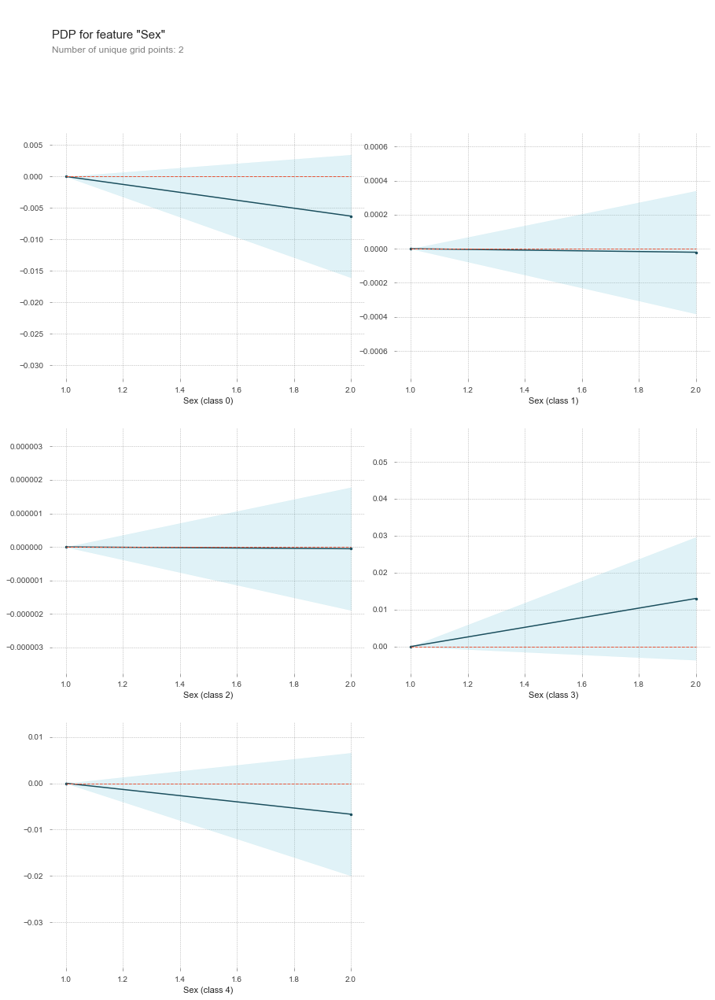

In [45]:
%matplotlib inline
import matplotlib.pyplot as plt
from pdpbox import pdp
feature = 'Sex'
pdp_dist = pdp.pdp_isolate(model=model, dataset=X_train_transformed, model_features=features, feature=feature)
pdp.pdp_plot(pdp_dist, feature);

In [46]:
row = X_test.iloc[[3094]]
explainer = shap.TreeExplainer(model)
row_processed = transformer.transform(row)
shap_values = explainer.shap_values(row_processed)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value[0], 
    shap_values=shap_values[0], 
    features=row, 
    link='logit' # For classification, this shows predicted probabilities
)

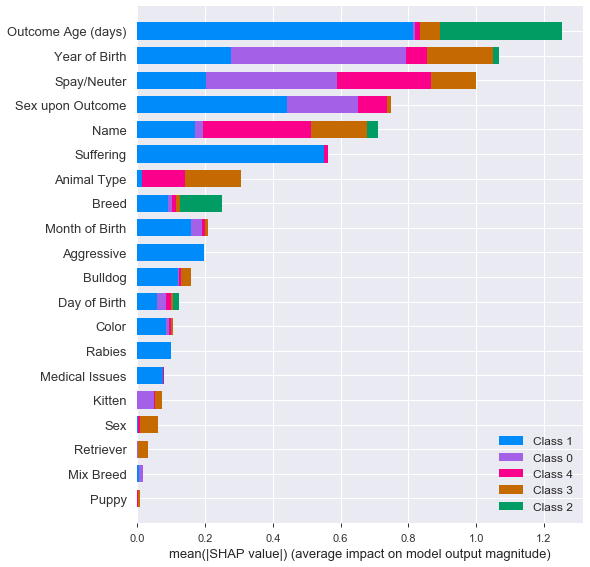

In [47]:
shap.summary_plot(shap_values, X_test, plot_type="bar")